In [91]:
!pip install mediapipe
!pip install sk-video

In [94]:
# adapted from these two sources: https://www.youtube.com/watch?v=LF7Lgz4_lus
# https://www.youtube.com/watch?v=V9bzew8A1tc

import cv2
import mediapipe as mp
import os
from google.colab.patches import cv2_imshow
import numpy as np
import skvideo.io
import matplotlib.pyplot as plt

path = "/content/drive/MyDrive/Senior Thesis/Colabs/speechnotspeech/nov7videos/"
videos = os.listdir(path)

In [96]:
# initialize facemesh modules

mp_drawing = mp.solutions.drawing_utils
mp_face_mesh = mp.solutions.face_mesh
facemesh = mp_face_mesh.FaceMesh(refine_landmarks = True)
drawing_spec = mp_drawing.DrawingSpec(thickness=1, circle_radius=1)

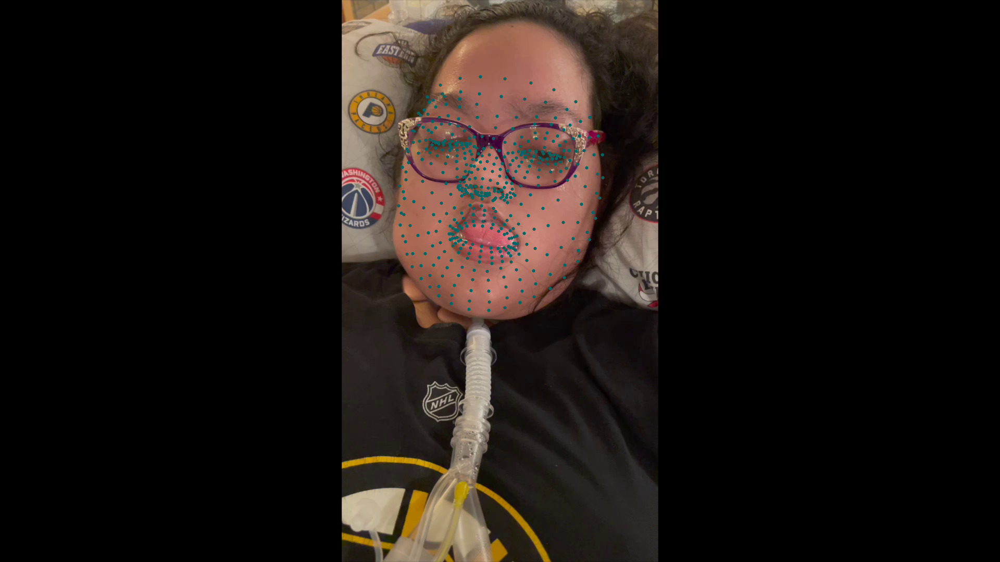

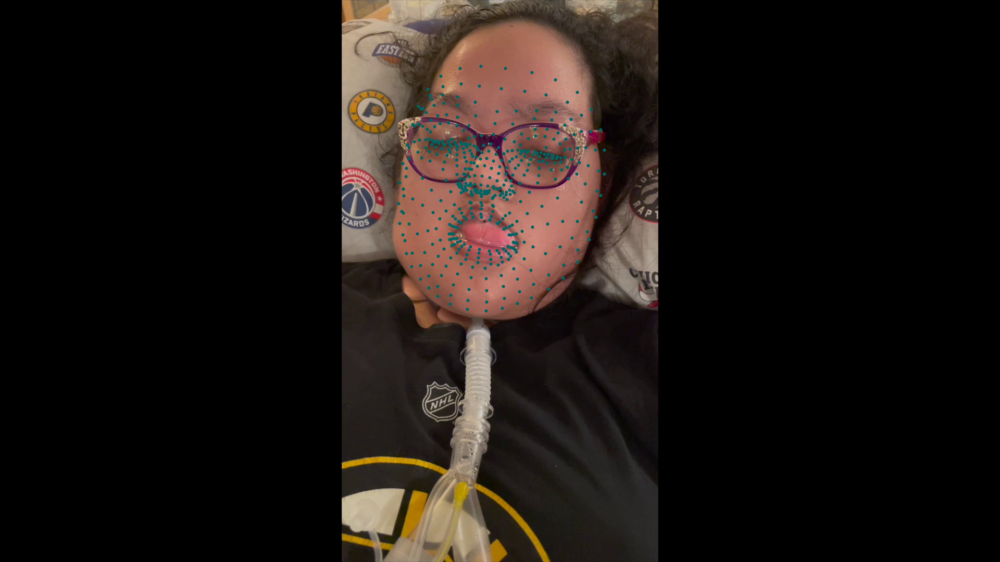

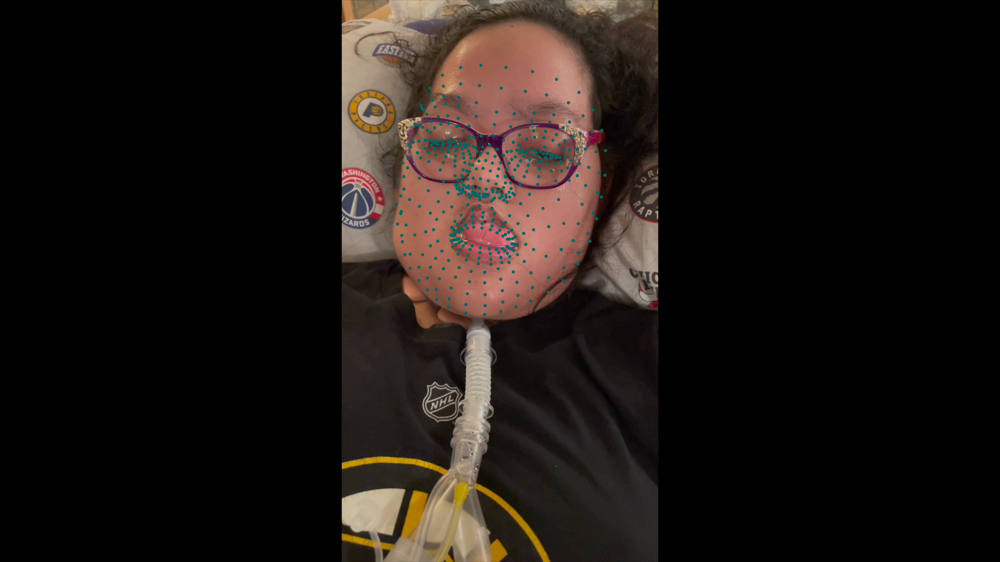

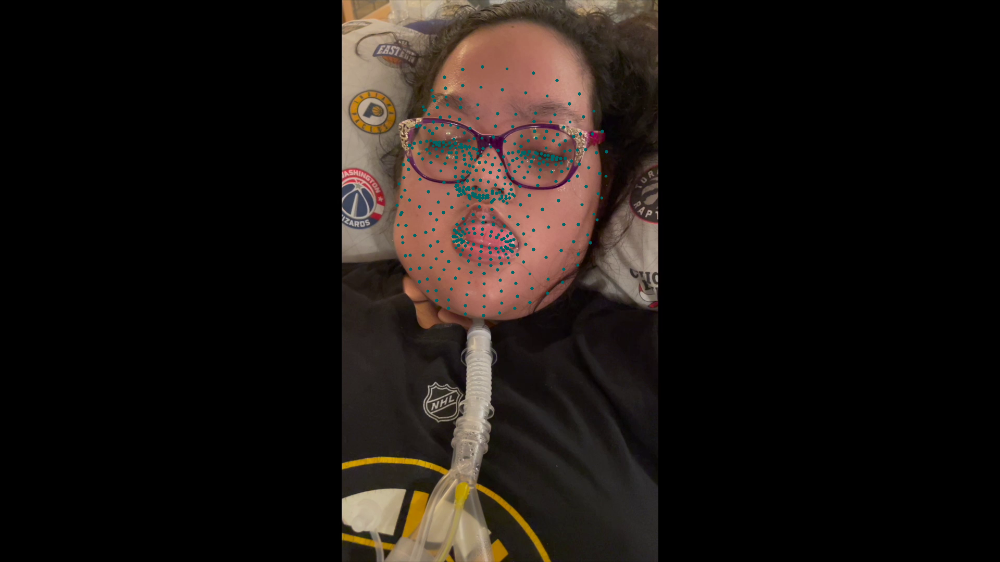

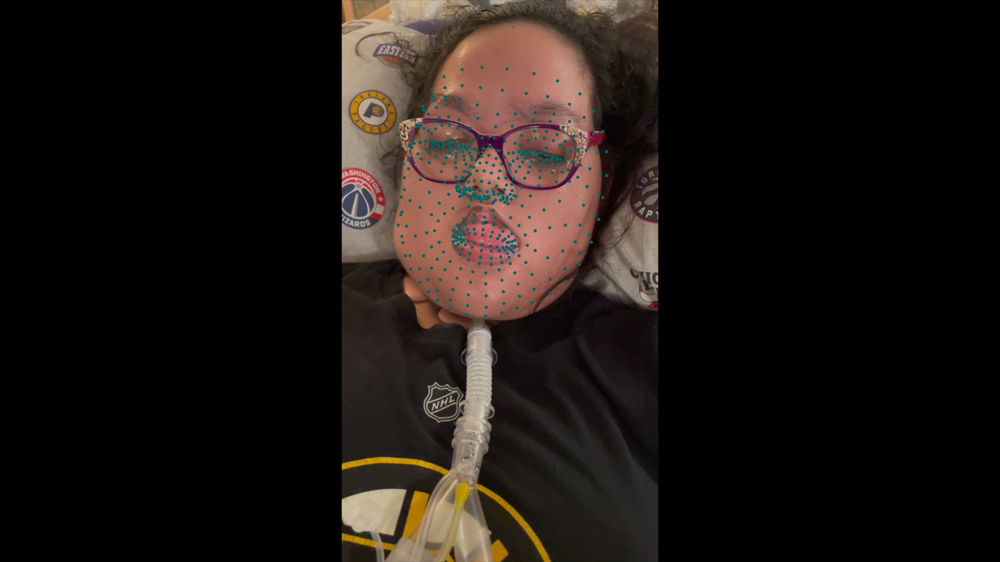

...

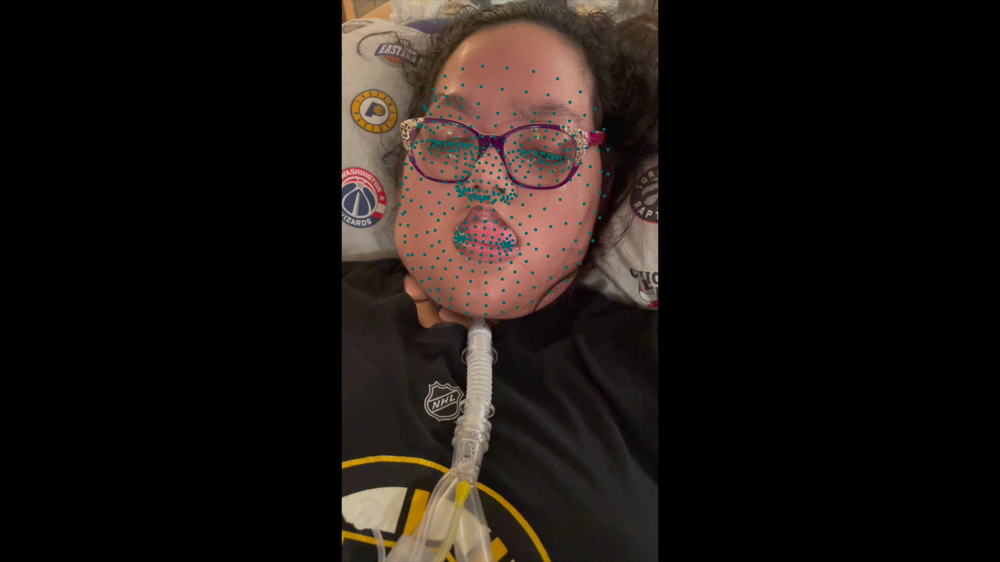

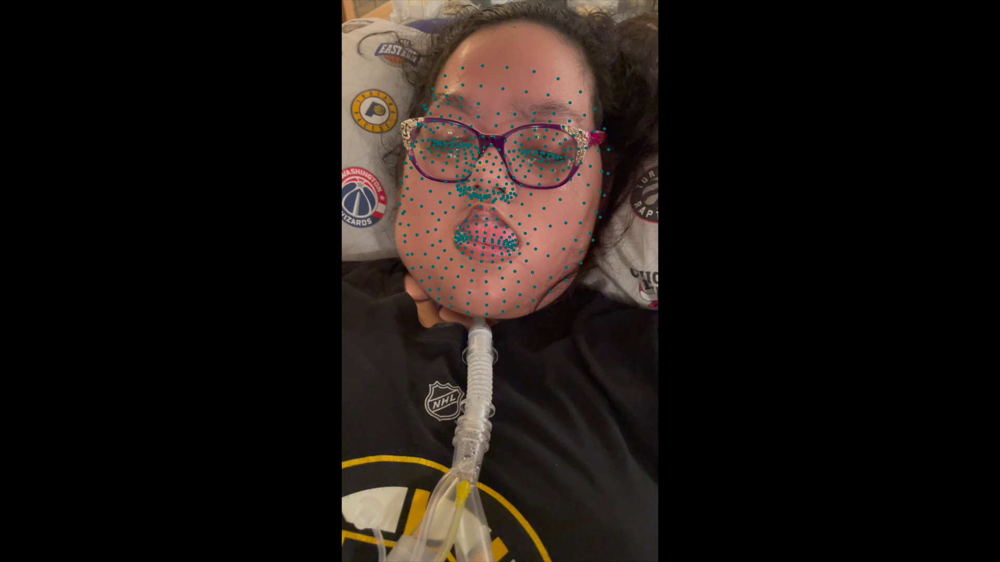

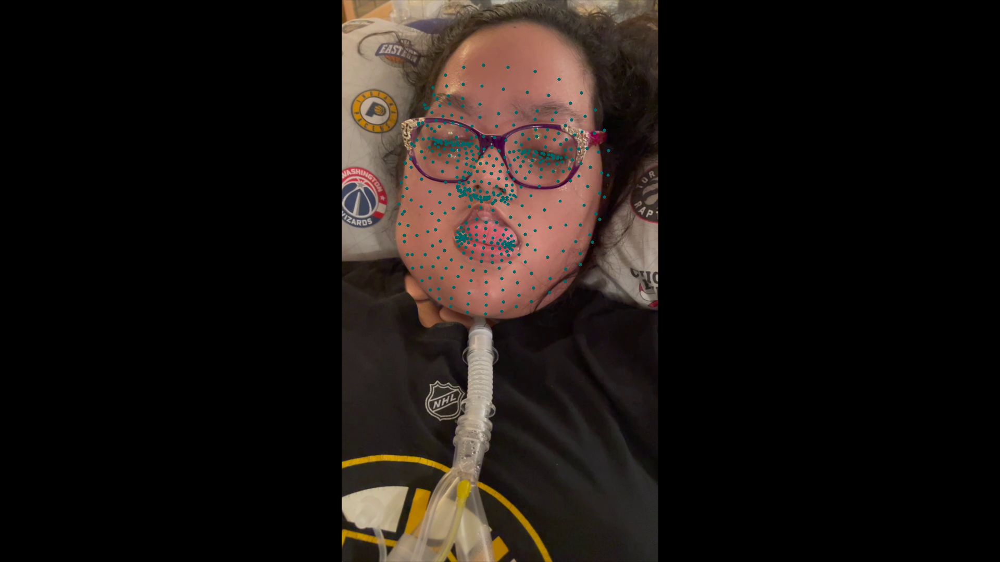

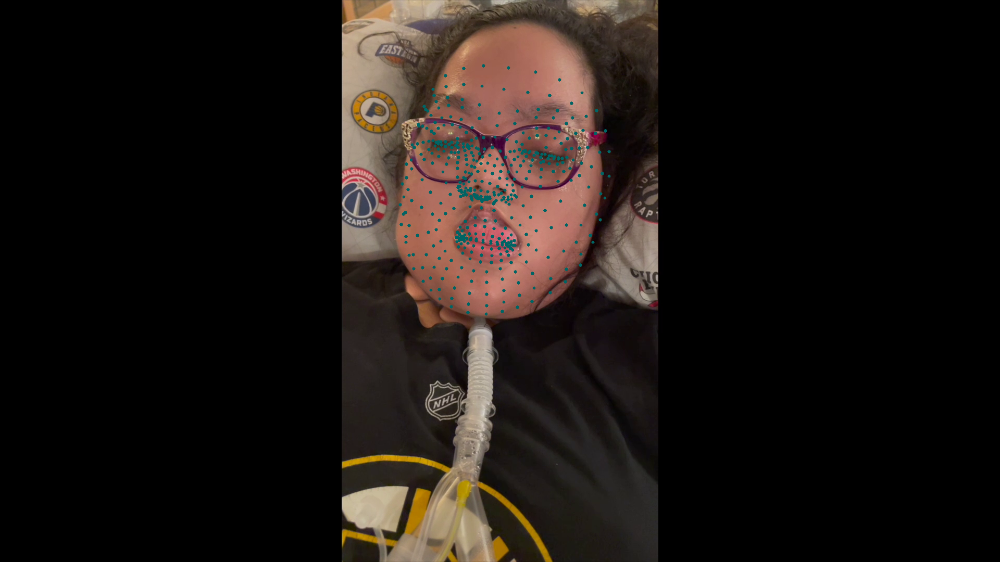

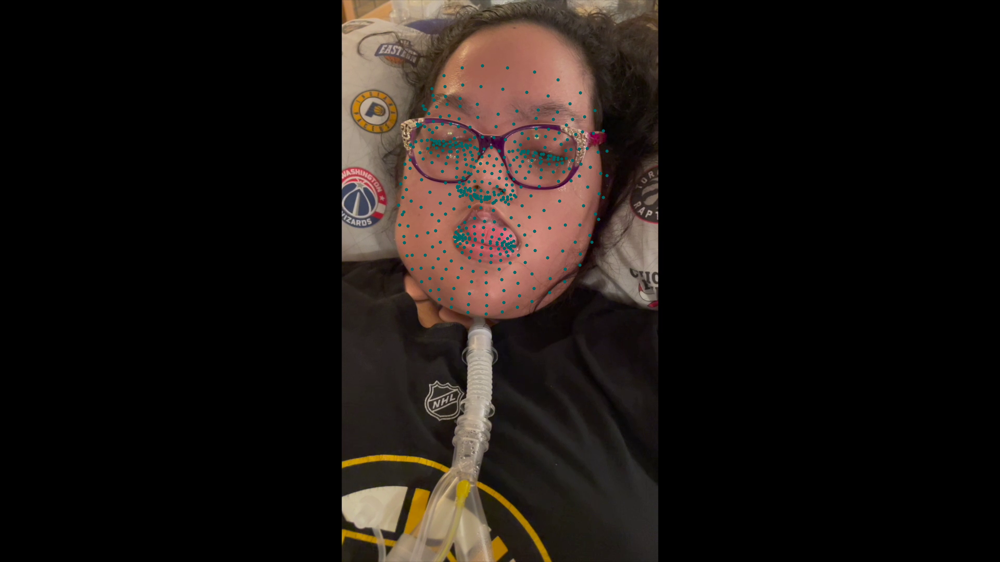

In [97]:
cur = f"{path}{videos[0]}"
cap = cv2.VideoCapture(cur)

arrays = []

while True:
  # extract frames from single video
  ret, image = cap.read()
  # break if frame doesn't exist
  if ret is not True:
    break
  
  height, width, _ = image.shape

  # initialize array to hold landmarks (x, y)
  landmark_array = np.zeros((478, 2))
  
  result = facemesh.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  
  for facial_landmarks in result.multi_face_landmarks:
    for i in range(0, 478):
        pt1 = facial_landmarks.landmark[i]
        x = int(pt1.x * width)
        y = int(pt1.y * height)

        landmark_array[i, 0] = x
        landmark_array[i, 1] = y
        
        cv2.circle(image, (x, y), 3, (100, 100, 0), -1)
  # add landmarks to array, show image with landmarks on it
  arrays.append(landmark_array)
  cv2_imshow(image)
  cv2.waitKey(1)

In [ ]:



# # create list of video frames
# frames = []

# for frame in video:
#   frames.append(frame)

# landmark_array = np.zeros((len(frames), 478, 2))

# for i, image in enumerate(frames):
#   results = facemesh.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
#   if results.multi_face_landmarks:
#     for landmarks in results.multi_face_landmarks:
#       for idx, lm in enumerate(landmarks.landmark):
#         ih, iw, ic = image.shape
#         landmark_array[i, idx, 0] = int(lm.x * iw)
#         landmark_array[i, idx, 1] = int(lm.y * ih)

In [ ]:
# https://github.com/google/mediapipe/blob/a908d668c730da128dfa8d9f6bd25d519d006692/mediapipe/modules/face_geometry/data/canonical_face_model_uv_visualization.png

rel = [x for x in range(468) if landmark_array[0, :, 0][x] < landmark_array[0, :, 0][432] and landmark_array[0, :, 0][x] > landmark_array[0, :, 0][212]]
rel = [i for i in rel if landmark_array[0, :, 1][i] > landmark_array[0, :, 1][2] and landmark_array[0, :, 1][i] < landmark_array[0, :, 1][200]]

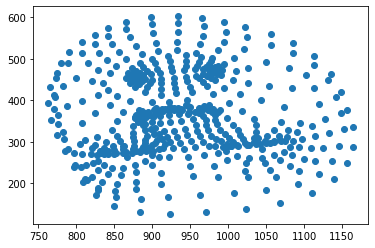

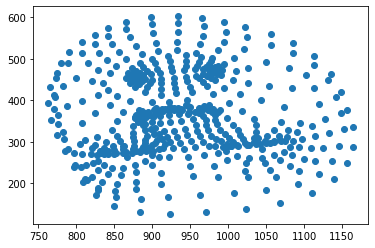

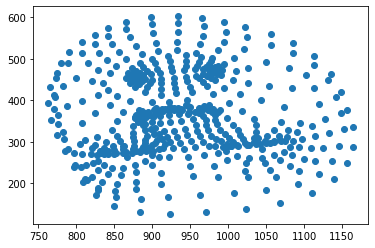

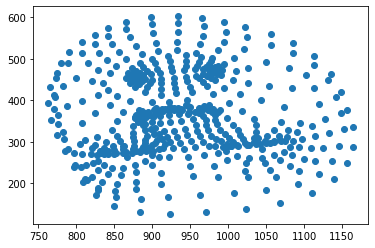

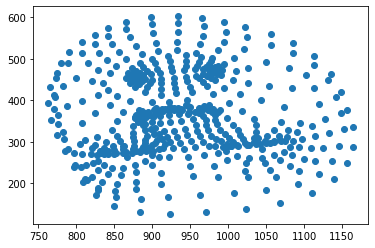

...

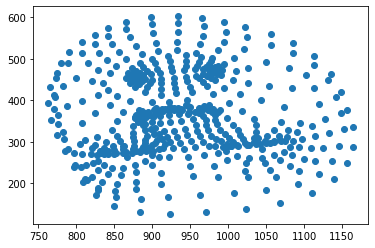

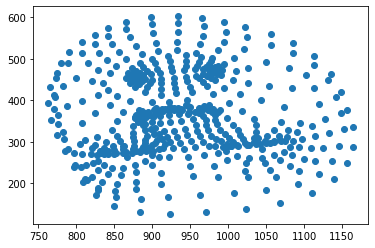

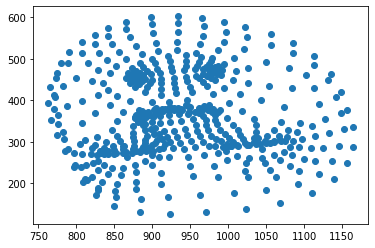

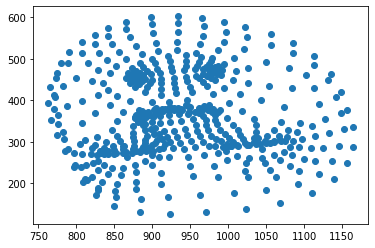

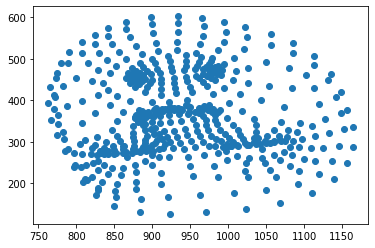

In [ ]:
for i in range(len(frames)):
  plt.scatter(arrays[0][:, 0], arrays[0][:, 1])
  plt.show()

In [ ]:
len(rel)

119